# Edge Detection and Segmnetation with Classical Methods
First goal is to separate FG from BG using as little user info about cells as possible.
As a second step I can use that as a prior for instances.

https://scikit-image.org/docs/stable/user_guide/tutorial_segmentation.html
- Canny
- Sobel
- Watershed

## General Notes
- PC artifacts rise from the BG and fall almost instantly in the cell [prove]
- not all cell boundaries have such artefacts

In [1]:

import skimage as ski


import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

import scipy as sc

import sys; sys.path += ['..']  # NOTE find shared modules
from util.preprocess import *
from util.plot import *

import colorcet
import itertools as it


def imshow(imgs_with_title,pts_pos=None, pts_neg=None, scale=5, slice=None, suptitle=None, pts_inst=None, gray=True, shape=None):
  global colors 
  if shape==None:
    shape = (len(imgs_with_title), 1)

  if shape==(2,1): shape = (1,2)
  if shape==(4,1): shape = (2,2)
  if shape==(6,1): shape = (3,2)
  if shape==(9,1): shape = (3,3)

  fig, axs = plt.subplots(*shape, figsize=(4*scale*shape[1], 3*scale*shape[0]))
  axs = axs.flat if len(imgs_with_title) > 1 else [axs]
  
  for ax, (img, tit) in zip(axs, imgs_with_title):
    if pts_inst is not None:
      ax.imshow(skimage.color.label2rgb(img, colors=colors))
    else: 
      ax.imshow(img, cmap=('gray' if gray and (len(img.shape)==2 or img.shape[2]==1) else 'viridis'))
    if pts_pos is not None:
      ax.scatter(pts_pos[:,1], pts_pos[:,0], s=scale*4*shape[0], marker='o', c='cyan')
    if pts_neg is not None:
      ax.scatter(pts_neg[:,1], pts_neg[:,0], s=scale*4*shape[0], c='red', marker='o')
    if pts_inst is not None:
      ax.scatter(pts_inst[:,1], pts_inst[:,0], s=scale*4*shape[0], c=colors, marker='o')
    ax.axis('off')
    if tit:
      ax.set_title(tit, fontsize=scale*7)

    match slice:
      case [x,X,y,Y]:
        ax.set_xlim([x,X])
        ax.set_ylim([y,Y])

  if suptitle:
    fig.suptitle(suptitle)

  plt.tight_layout()
  plt.show()

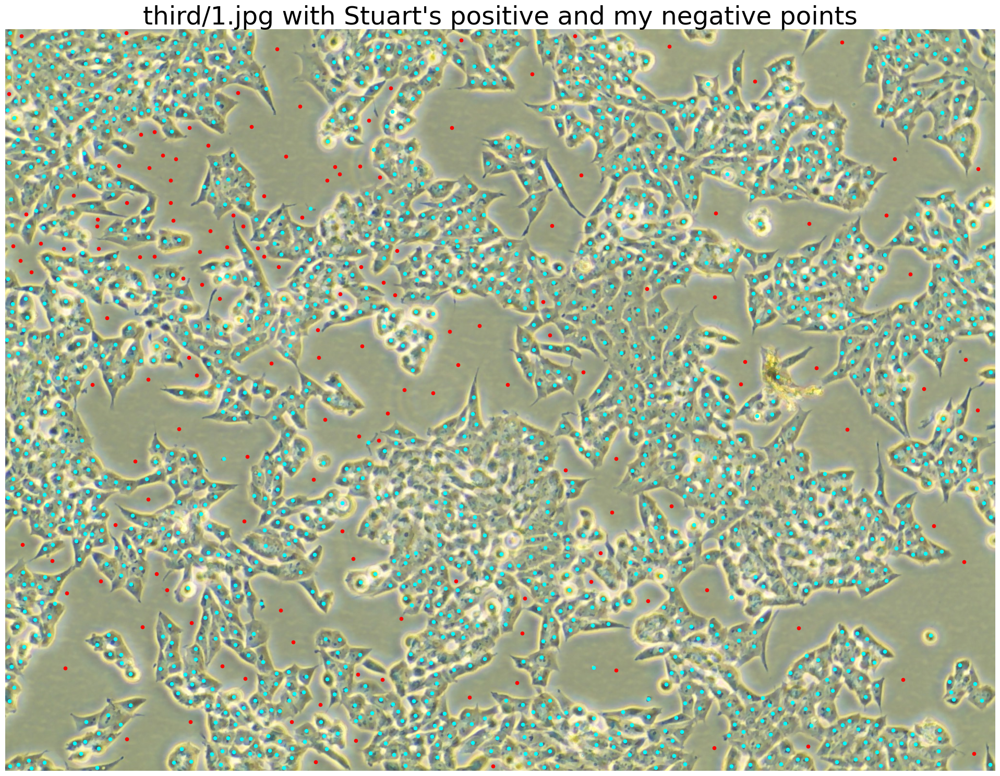

In [2]:
img_rgb = ski.io.imread('../data/third/1.jpg')

img = ski.color.rgb2gray(img_rgb)
pts = preprocess_point('../data/third/annotations.json')
pts_neg = preprocess_point('../data/third/annot-bg.json')

colors = colorcet.m_glasbey.colors
colors = [c for c, (x,y) in zip(it.cycle(colors), pts)]

imshow([(img_rgb, 'third/1.jpg with Stuart\'s positive and my negative points'),
], pts, pts_neg)

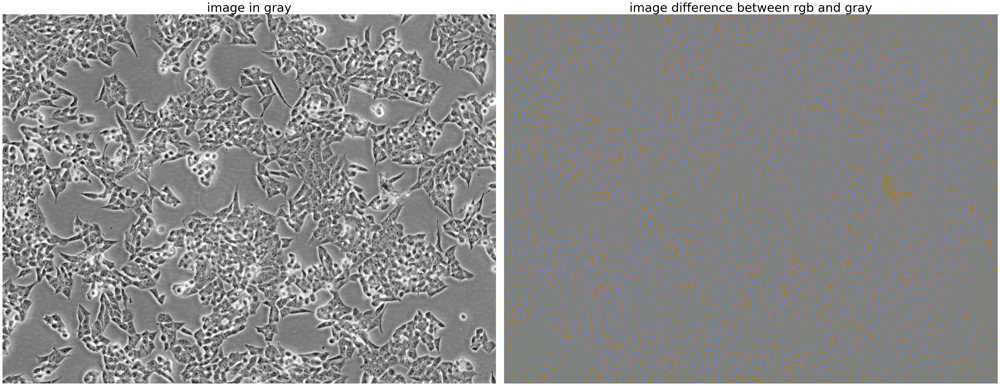

In [3]:
img_diff = img_rgb/img_rgb.max()-np.repeat(img[:,:,None], 3, axis=2)/img.max()
# subtract the mean for each color
img_diff -= img_diff.mean(axis=(0,1))
img_diff -= img_diff.min()
imshow([
        (img, 'image in gray'),
        (img_diff, 'image difference between rgb and gray')
])

## Canny Edge Detection
- great in finding edges
- bad in enclosing something (edges have holes)
- confused by PC artifacts (inconsistent depending on intensity + sometimes closed / sometimes holed)
 - thats why binary_fill_holes detects only very few cells
 - and removing small objects will remove all but very few blobs
The tutorial proposes dilating or using a more robust method

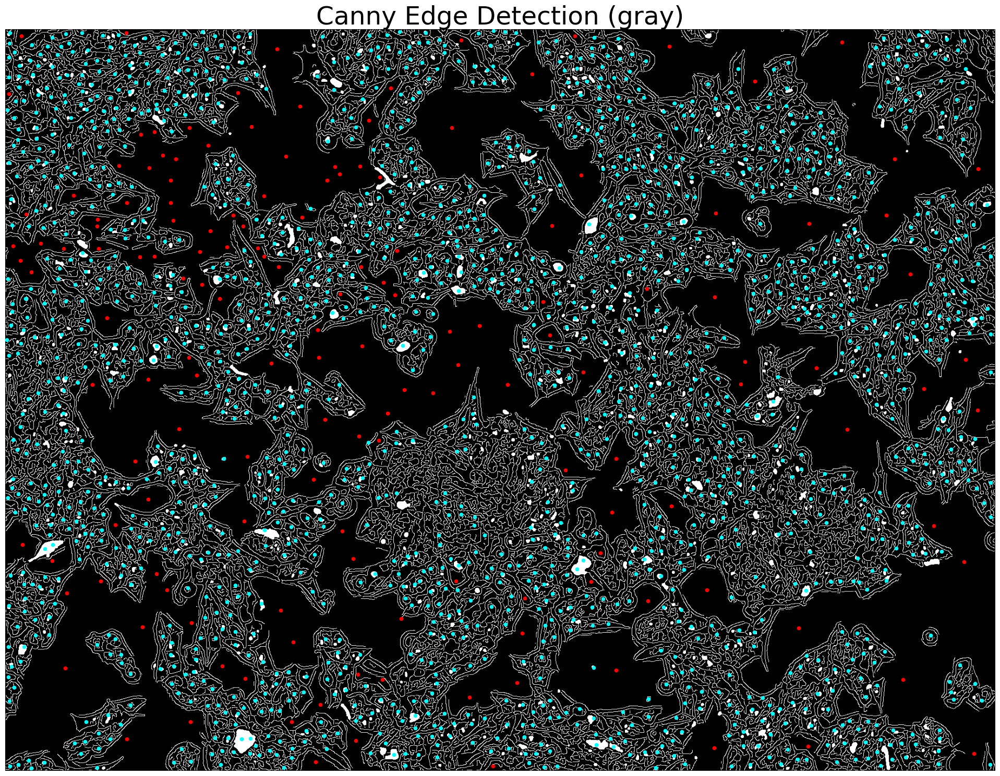

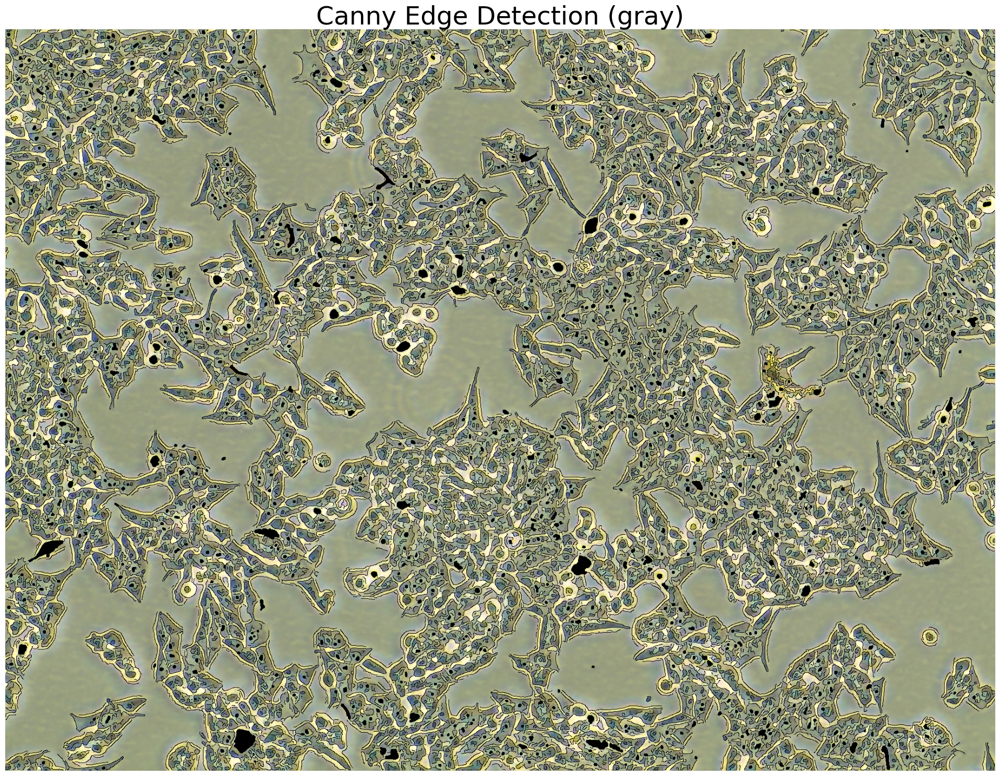

In [4]:

edges_canny = ski.feature.canny(img)

canny = sc.ndimage.binary_fill_holes(edges_canny)

imshow([(canny.astype(int), "Canny Edge Detection (gray)")], pts, pts_neg)

img_with_canny = img_rgb.copy()
img_with_canny[canny] = 0
imshow([(img_with_canny, "Canny Edge Detection (gray)")])

## Watershed 
- need markers for _both_ BG and FG (otherwise no results because everything gets flooded as there is no contra stream)
- can try different methods for elevation map 
  - Sobel filter
- **could try to determine such method(/settings) through ML**

Later: can use a different marker label for each cell dot to generate instances:
 ```
source_instances_with_bg = np.zeros_like(img, dtype=np.int16)
source_instances_with_bg[pts[:,0], pts[:,1]] = np.arange(pts.shape[0])+2
source_instances_with_bg[pts_neg[:,0], pts_neg[:,1]] = 1
```
### Results
- inversing (gray/rgb) image or sobel makes shitty results
- gray image better than color image
- gray sobel better than color sobel
- sobel better than image

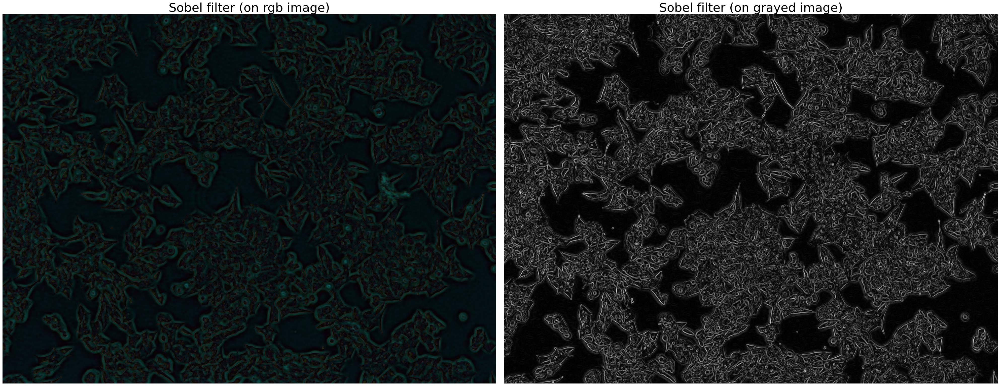

In [5]:

sobel = ski.filters.sobel(img)
sobel_rgb = ski.filters.sobel(img_rgb)
sobel_and_canny = sobel.copy()

imshow([(sobel_rgb, "Sobel filter (on rgb image)"), (sobel, "Sobel filter (on grayed image)")])

In [6]:

ws_FG_BG = np.zeros_like(img, dtype=np.int16)
ws_FG_BG[pts[:,0], pts[:,1]] = 1
ws_FG_BG[pts_neg[:,0], pts_neg[:,1]] = 2

ws_FG_bg = np.zeros_like(img, dtype=np.int16)
ws_FG_bg[pts[:,0], pts[:,1]] = 1
ws_FG_bg[pts_neg[:,0], pts_neg[:,1]] = -1

ws_fg_BG = -ws_FG_bg



from skimage import filters as f

def norm(x): return (x-x.min())/(x.max()-x.min())

butter = f.butterworth(img, 0.2)  # we cut of edge artifacts so that normalization is more dirable

butter = f.butterworth(butter, 0.18, high_pass=False)



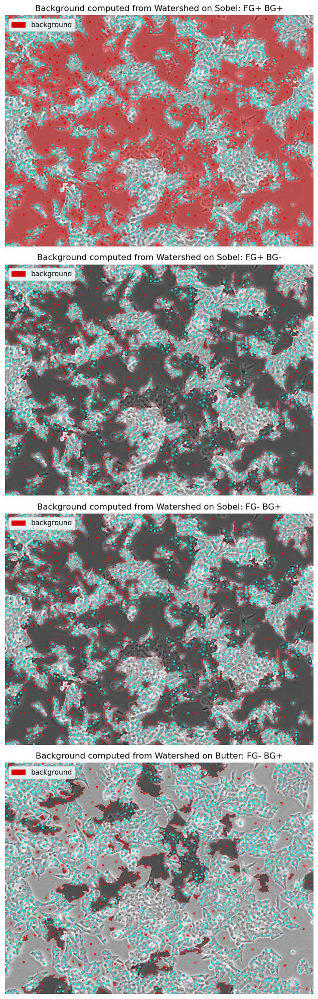

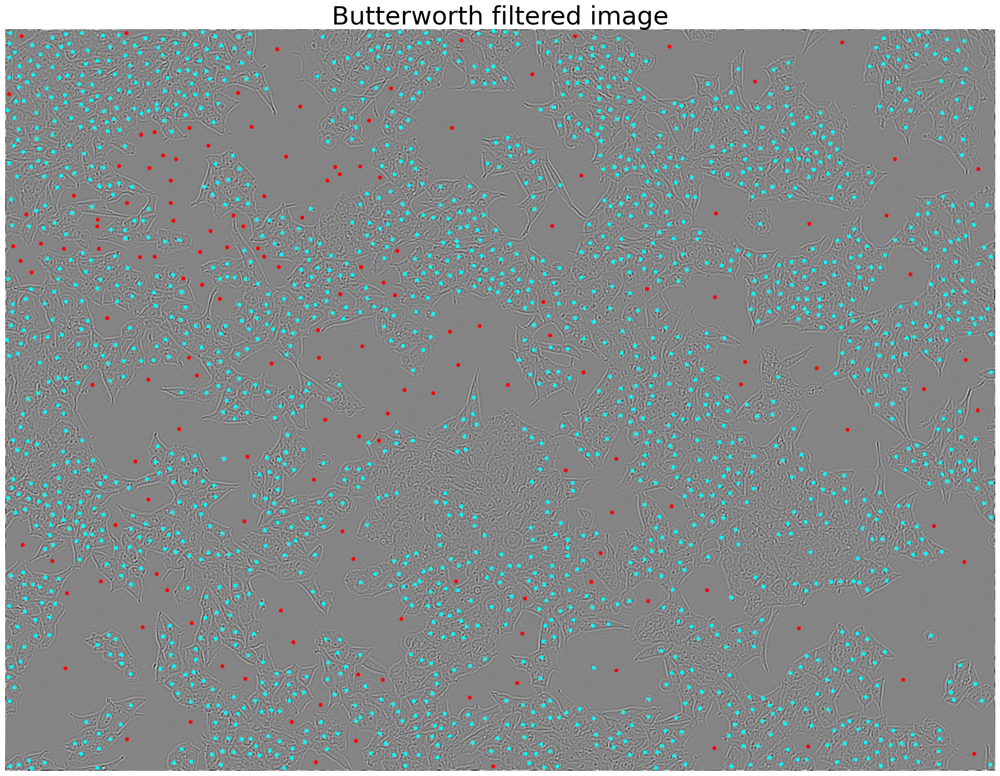

In [7]:
# I call this the data-n-do pattern


stuff = [
  ([(sobel, 'background')], 
  ws_FG_BG, "Background computed from Watershed on Sobel: FG+ BG+", 1),

  ([(sobel, 'background')], 
  ws_FG_bg, "Background computed from Watershed on Sobel: FG+ BG-", -1),

  ([(sobel, 'background')], 
  ws_fg_BG, "Background computed from Watershed on Sobel: FG- BG+", 1),

  ([(butter, 'background')],
   ws_fg_BG, "Background computed from Watershed on Butter: FG- BG+", 1),

]

scale = 20
fig, axs = plt.subplots(len(stuff),1, figsize=(scale,scale))

for ax, x in zip(axs, stuff):
  #ax.imshow(img_rgb)
  out = img.copy()

  patches = []
  for (elevatation, label), color in zip(x[0], colors):
    ws = ski.segmentation.watershed(elevatation, markers=x[1])
    ws[ws==x[3]]=0

    if x[3] < 0: ws = -ws


    out = ski.color.label2rgb(ws, out, saturation=1, bg_color=None, alpha=0.5, colors=[color])

    # draw the binary mask in ws as overlay with color and alpha
    ax.imshow(ws, alpha=0.5)
    patch = mpatches.Patch(color=color, label=label)
    patches.append(patch)
    ax.imshow(ski.segmentation.mark_boundaries(out, ws, color=color))

  ax.legend(handles=patches, loc='upper left')
  
  ax.scatter(pts[:,1], pts[:,0], s=scale/8, c='cyan', marker='o')
  ax.scatter(pts_neg[:,1], pts_neg[:,0], s=scale/8, c='red', marker='D')
  ax.axis('off')

  ax.set_title(x[2])

plt.tight_layout()

imshow([(butter, 'Butterworth filtered image')], pts, pts_neg, shape=(1,1))

# TODO

## Watershed
- try different elevation maps
- maybe ML learn best elevation map settings: differentiate the parameters with respect to a usual CV loss on the segmentation?

## Tiling
- show mini tile in grid for dense comparision of methods
- determine good tiles, calculate density on good annotated ttiles, evaluate,

# TODO 
- continue with centernet / keypoint detection and leave improving watershed for later

# TODO
- also try thresholding + connected components because BG is quite uniform 
  - may be to rigid to deal well with the PC artifacts (can I get rid of them somehow lol?)